In [1]:
import os
import time
import numpy as np
import pandas as pd
import random
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import torch.nn.functional as F

In [2]:
!nvidia-smi

Mon Jun 21 13:06:05 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.27       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8    27W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
from google.colab import drive
drive.mount("/content/gdrive/")

Mounted at /content/gdrive/


In [4]:
cd /content/gdrive/Shareddrives/Disk1

/content/gdrive/Shareddrives/Disk1


In [5]:
#!git clone "https://github.com/ShramanPal/InfoPro-Pytorch.git"

In [6]:
cd 'InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10'

/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10


## Experiments

In [ ]:
start_time = time.time()

In [ ]:
%%shell
CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode cross_entropy --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 20.0 --beta_2 20.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/exp_cosine_loss/no_1_aux_net_config_1c2f_local_loss_mode_cross_entropy_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_20.0_beta_2_20.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_baseline
170499072it [00:02, 61858214.40it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (1000,) and unused (8800,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  500  Label 2 samples =  500
Worker 2 Set:-
Label 1 samples =  500  Label 2 samples =  500
DataLoader 1 samples =  1024
DataLoader 2 samples =  1024
Sample Batch...

tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1])
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1])
W1 Epoch: [0][1/16]	Time 1.485 (1.485)	Loss 14.2627 (14.2627)	Prec@1 50.000 (50.000)	
W2 Epoch: [0][1/16]	Time 1.485 (1.485)	Loss 17.199

In [ ]:
%%shell
CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode cross_entropy --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 2.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.1 --skewness_ratio 0.5 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/exp_cosine_loss/more_epochs/no_1_aux_net_config_1c2f_local_loss_mode_cross_entropy_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_2.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.1_skewness_rate_0.5
Files already downloaded and verified
Files already downloaded and verified
No of samples used (1000,) and unused (8800,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  250  Label 2 samples =  250
Worker 2 Set:-
Label 1 samples =  250  Label 2 samples =  250
DataLoader 1 samples =  512
DataLoader 2 samples =  512
Sample Batch...

tensor([1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0])
Chunk 1 contrastive : 0.9472938776016235
Total Loss =  tensor(6.9334, grad_fn=<AddBackward0>)
Chunk 2 Contrastive Loss =  0.030360260978341103
W1 Epoch: [0][1/8]	Time 1.873 (1.873)	Loss 0.7222 (0.7222)	Prec@1 57.812 (57.812)

In [ ]:
print("Total time = ", time.time() - start_time)

Total time =  471.7222661972046


In [ ]:
import operator
names = ["index", "time", "loss", "accuracy", "dump"]

def traindata(df1,df2):
  lis=[df2.loc[df2['index']==x,:] for x in df2['index'] if operator.contains(x,'Val')]
  df2_val=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)

  lis=[df2.loc[df2['index']==x,:] for x in df2['index'] if operator.contains(x,'Epoch')]
  df2=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)
  
  lis=[df1.loc[df1['index']==x,:] for x in df1['index'] if operator.contains(x,'Val')]
  df1_val=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)

  lis=[df1.loc[df1['index']==x,:] for x in df1['index'] if operator.contains(x,'Epoch')]
  df1=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)
  return df1,df1_val,df2,df2_val

## Fixing Dataset Size

#### Total 1000 samples (current case)

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/dataset_comparison/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5
170499072it [00:02, 73565122.74it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (1000,) and unused (6000,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  500  Label 2 samples =  500
Worker 2 Set:-
Label 1 samples =  500  Label 2 samples =  500
DataLoader 1 samples =  1024
DataLoader 2 samples =  1024
Sample Batch...

tensor([0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1])
tensor([1, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 0, 1, 1])
W1 Epoch: [0][1/16]	Time 1.583 (1.583)	Loss 0.6706 (0.6706)	Prec@1 59.375 (59.375)	
W2 Epoch: [0][1/16]	Time 1.583 (1.583)	Loss 0.7548 (0.7548)	Prec@

#### Total 500 samples

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/dataset_comparison/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_500
Files already downloaded and verified
Files already downloaded and verified
No of samples used (500,) and unused (8000,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  250  Label 2 samples =  250
Worker 2 Set:-
Label 1 samples =  250  Label 2 samples =  250
DataLoader 1 samples =  512
DataLoader 2 samples =  512
Sample Batch...

tensor([1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1])
tensor([1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1])
W1 Epoch: [0][1/8]	Time 1.550 (1.550)	Loss 0.7492 (0.7492)	Prec@1 50.000 (50.000)	
W2 Epoch: [0][1/8]	Time 1.550 (1.550)	Loss 0.7050 (0.7050)	Prec@1 51.562 (51.562)	
W1 Epoch: [0][2/8]	Time 1.400 (1.475)	Loss 0.7428 (0.7460)	Prec@1 53.

#### Total 250 samples

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f 

##3 worker more epochs (200)

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_2.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.333 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/3_models/32_batchsize/100x/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.333_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (300,) and unused (9000,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  49  Label 2 samples =  49
Worker 2 Set:-
Label 1 samples =  51  Label 2 samples =  52
Worker 3 Set:-
Label 1 samples =  50  Label 2 samples =  49
W1 Epoch: [0][1/4]	Time 1.273 (1.273)	Loss 0.6954 (0.6954)	Prec@1 50.000 (50.000)	
W2 Epoch: [0][1/4]	Time 1.273 (1.273)	Loss 1.3961 (1.3961)	Prec@1 46.875 (46.875)	
W3 Epoch: [0][1/4]	Time 1.273 (1.273)	Loss 0.6716 (0.6716)	Prec@1 65.625 (65.625)	
W1 Epoch: [0][2/4]	Time 1.164 (1.219)	Loss 0.7333 (0.7143)	Prec@1 40.625 (45.312)	
W2 Epoch: [0][2/4]	Time 1.164 (1.219)	Loss 1.453

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_2.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 0.0 --skewness_ratio 0.333 --aux_net_config 1c2f 

Storing in ... ./InfoPro_cifar10_resnet16_K_2_/3_models/32_batchsize/100x/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_0.0_skewness_rate_0.333_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (300,) and unused (9000,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  49  Label 2 samples =  49
Worker 2 Set:-
Label 1 samples =  51  Label 2 samples =  52
Worker 3 Set:-
Label 1 samples =  50  Label 2 samples =  49
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1])
tensor([0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1])
tensor([1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 0])
W1 Epoch: [0][1/4]	Time 1.537 (1.537)	Loss 0.6820 (0.6820)	Prec@1 53.125 (53.125)	
W2 Epoch: [0][1/4]	Time 1.537 (1.537)	Loss 0.9033 (0.9033)	Prec@1 46.875 (46.875)	
W3 Epoc

## Loss functions

In [ ]:
class E_CosineLoss(torch.nn.Module):
  def __init__(self, margin, a=1.0, b=100.0):
    super(E_CosineLoss, self).__init__()
    self.cosine_margin = margin
    self.positive_weight = b
    self.negative_weight = a
  
  def forward(self, X, Y, target1, target2):
    x_norm = F.normalize(X)
    y_norm = F.normalize(Y)
    batch_size = X.size(0)
    Z = torch.matmul(x_norm, y_norm.t())
    Z = torch.exp(Z)/torch.sum(torch.exp(Z), dim=1, keepdims=True)
    pos_mask = torch.zeros((batch_size, batch_size))
    neg_mask = torch.zeros((batch_size, batch_size))
    for i in range(batch_size):
      for j in range(batch_size):
        if t1[i] == t2[j]:
          pos_mask[i][j] = 1 
        else:
          neg_mask[i][j] = 1
    if torch.cuda.is_available():
      pos_mask = pos_mask.cuda()
      neg_mask = neg_mask.cuda()
    positive_values = torch.mul(pos_mask, Z)
    negative_values = torch.mul(neg_mask, Z)
    s1 = torch.sum(positive_values)          #sum of positives
    s2 = torch.sum(negative_values)          #sum of negatives
    print("+ve loss = ", self.positive_weight/s1, "\n-ve loss = ", self.negative_weight*s2,"\n")
    loss = (self.positive_weight/s1 + self.negative_weight*s2)/batch_size
    return loss

class LE_CosineLoss(torch.nn.Module):
  def __init__(self, margin, a=1.0, b=100.0):
    super(LE_CosineLoss, self).__init__()
    self.cosine_margin = margin
    self.positive_weight = b
    self.negative_weight = a
  
  def forward(self, X, Y, target1, target2):
    x_norm = F.normalize(X)
    y_norm = F.normalize(Y)
    batch_size = X.size(0)
    Z = torch.matmul(x_norm, y_norm.t()).type(torch.double)
    Z = torch.exp(Z)/torch.sum(torch.exp(Z), dim=1, keepdims=True)
    pos_mask = torch.zeros((batch_size, batch_size), dtype=torch.int32)
    neg_mask = torch.zeros((batch_size, batch_size), dtype=torch.int32)
    for i in range(batch_size):
      for j in range(batch_size):
        if t1[i] == t2[j]:
          pos_mask[i][j] = 1 
        else:
          neg_mask[i][j] = 1
    if torch.cuda.is_available():
      pos_mask = pos_mask.cuda()
      neg_mask = neg_mask.cuda()
    positive_values = torch.where(pos_mask == 0, 1.0, Z)
    negative_values = torch.mul(neg_mask, Z)
    s1 = -torch.sum(torch.log(positive_values))              #sum of positives
    s2 = -torch.sum(torch.log(1 - negative_values))          #sum of negatives
    print("+ve loss = ", self.positive_weight*s1, "\n-ve loss = ", self.negative_weight*s2,"\n")
    loss = (self.positive_weight*s1 + self.negative_weight*s2)/batch_size
    return loss

In [ ]:
x = torch.rand((32, 128))
y = torch.rand((32, 128))
e_loss = E_CosineLoss(1.0, 1.0, 100.0)
le_loss = LE_CosineLoss(1.0, 1.0, 1e-2)
t1 = torch.zeros((32))
t2 = torch.zeros((32))
n1 = random.sample(range(0, 32), 18)
n2 = random.sample(range(0, 32), 14)
for i in n1:
  t1[i] = 1
for i in n2:
  t2[i] = 1

In [ ]:
print("Without Log = \n")
z1=e_loss(x, y, t1, t2)
print(z1)
print("\nWith Log = \n")
z2=le_loss(x, y, t1, t2)
print(z2)

Without Log = 

+ve loss =  tensor(6.3429) 
-ve loss =  tensor(16.2342) 

tensor(0.7055)

With Log = 

+ve loss =  tensor(17.4640, dtype=torch.float64) 
-ve loss =  tensor(16.4932, dtype=torch.float64) 

tensor(1.0612, dtype=torch.float64)


## Loss Functions vs Accuracies

### Distance Loss

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
170499072it [00:02, 78013550.35it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

ten

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.01 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.01_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.1 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.1_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 10.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_10.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.25 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.25_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.75 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.75_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 2.0 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_2.0_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 2.0 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_2.0_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 2.0 --negative_weight 1000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_2.0_a_1000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1,

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.75 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_1.75_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.75 --negative_weight 10000.0 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_1.75_a_10000.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

### AMC Loss

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 10 --positive_weight 0.001 --contrastive_loss_margin 1.0  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_1.0_a_10.0_b_0.001_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.1 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 10 --positive_weight 0.001 --contrastive_loss_margin 1.0  

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 10 --positive_weight 0.001 --contrastive_loss_margin 1.0  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_1.0_a_10.0_b_0.001_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 10 --positive_weight 0.1 --contrastive_loss_margin 0.7

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.7_a_10.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.1 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.1_gamma_2_0.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 10.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_10.0_gamma_2_0.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.25 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.25_gamma_2_1.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
170499072it [00:03, 46356361.46it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.25 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --negative_weight 1000 --positive_weight 1.0 --contrastive_loss_margin 0.6  

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.25_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0, 

### Log Exp Cosine Loss

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 1 --positive_weight 0.01 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_0.01_exp
170499072it [00:03, 54987066.05it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 1 --positive_weight 0.01 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_0.01_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 10 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_10.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 10 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_10.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 10 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_10.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 10 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_10.0_b_0.1_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_1.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0,

### MinMax Loss

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 1 --positive_weight 100

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_100.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 1 --positive_weight 100

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_100.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 1 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_100000.0_exp
170499072it [00:05, 28862425.02it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

ten

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 1 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_1.0_b_100000.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 0 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_0.0_b_100000.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 0 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_0.0_b_100000.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.5 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 0 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.5_skewness_rate_0.5_m_0.5_a_0.0_b_100000.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.25 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "mcosine" --negative_weight 0 --positive_weight 100000

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/mcosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.25_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_0.0_b_100000.0_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 

### Exp Cosine Loss

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "ecosine" --negative_weight 1 --positive_weight 0.001 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/ecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_1.0_b_0.001_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "ecosine" --negative_weight 0 --positive_weight 0.01 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/loss_function/ecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.01_exp
Files already downloaded and verified
Files already downloaded and verified
No of samples used (128,) and unused (9872,)
No of samples used (2000,) and unused (0,)
Worker 1 Set:-
Label 1 samples =  32  Label 2 samples =  32
Worker 2 Set:-
Label 1 samples =  32  Label 2 samples =  32
DataLoader 1 samples =  64
DataLoader 2 samples =  64
Sample Batch...

tensor([1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1])
tensor([0, 1, 0, 1, 1, 0,

## Plots

In [ ]:
df=pd.read_csv("pos_neg_lecosine_exp.csv", header=None)
df

,0,1
0,0.0,0.990382
1,0.0,1.118074
2,0.0,1.115479
3,0.0,1.512109
4,0.0,1.246566
...,...,...
895,0.0,2.086536
896,0.0,2.132938
897,0.0,1.818911
898,0.0,2.302555


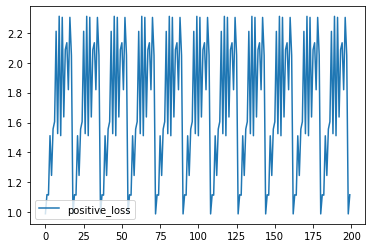

In [ ]:
#plt.plot(df.iloc[:120, 0], label="negative_loss")
plt.plot(df.iloc[:200, 1], label="positive_loss")
plt.legend()
plt.show()

In [ ]:
names = ["index", "time", "loss", "accuracy", "dump"]
import operator
def traindata(df1,df2):
  lis=[df2.loc[df2['index']==x,:] for x in df2['index'] if operator.contains(x,'Val')]
  df2_val=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)

  lis=[df2.loc[df2['index']==x,:] for x in df2['index'] if operator.contains(x,'Epoch')]
  df2=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)
  
  lis=[df1.loc[df1['index']==x,:] for x in df1['index'] if operator.contains(x,'Val')]
  df1_val=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)

  lis=[df1.loc[df1['index']==x,:] for x in df1['index'] if operator.contains(x,'Epoch')]
  df1=pd.DataFrame(np.array(lis).reshape(-1,5),columns=names)
  return df1,df1_val,df2,df2_val

(1600, 5)


Text(0.5, 1.0, 'gamma_1=0.25')

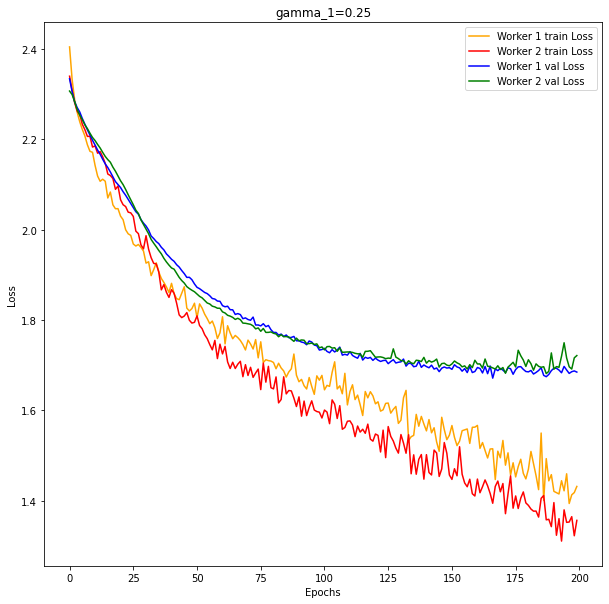

In [ ]:
path1='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.001/training_process1.txt'
path2='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.001/training_process2.txt'
plt.figure(figsize=(10, 10))
df1 = pd.read_csv(path1, sep="\t", header=None, names=names)
df2 = pd.read_csv(path2, sep="\t", header=None, names=names)

df1,df1_val,df2,df2_val=traindata(df1,df2)
print(df1.shape)
l1 = []
l2 = []
l1_val = []
l2_val = []
batchs=8
i=-1

for element1, element2 in zip(df1.loss, df2.loss):
  i+=1
  if i%batchs==0:
    ele1 = element1.split("(")
    ele2 = element2.split("(")
    ele1 = ele1[1].split(")")
    ele2 = ele2[1].split(")")
    l1.append(float(ele1[0]))
    l2.append(float(ele2[0]))

for element1_val, element2_val in zip(df1_val.loss, df2_val.loss):
  ele1_val = element1_val.split("(")
  ele2_val = element2_val.split("(")
  ele1_val = ele1_val[1].split(")")
  ele2_val = ele2_val[1].split(")")
  l1_val.append(float(ele1_val[0]))
  l2_val.append(float(ele2_val[0]))

plt.plot(l1, label = "Worker 1 train Loss",c='orange')
plt.plot(l2, label = "Worker 2 train Loss",c='red')
plt.plot(l1_val, label = "Worker 1 val Loss",c='blue')
plt.plot(l2_val, label = "Worker 2 val Loss",c='green')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gamma_1=0.25")

Text(0.5, 1.0, 'gamma_1=0.25')

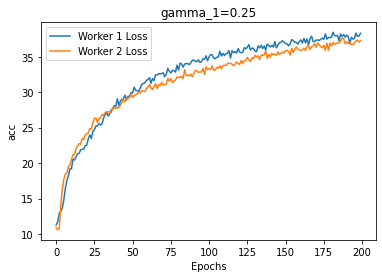

In [ ]:
path3='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.001/accuracy_epoch1.txt'
path4='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.001/accuracy_epoch2.txt'
#accuracy
df3 = pd.read_csv(path3, sep="\t", header=None, names = ["acc"])
df4 = pd.read_csv(path4, sep="\t", header=None, names = ["acc"])

l3 = []
l4 = []
for element3, element4 in zip(df3.acc, df4.acc):
  l3.append(element3)
  l4.append(element4)

plt.plot(l3, label = "Worker 1 Loss")
plt.plot(l4, label = "Worker 2 Loss")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("acc")
plt.title('gamma_1=0.25')

(900, 5)


Text(0.5, 1.0, 'gamma_1=0.25')

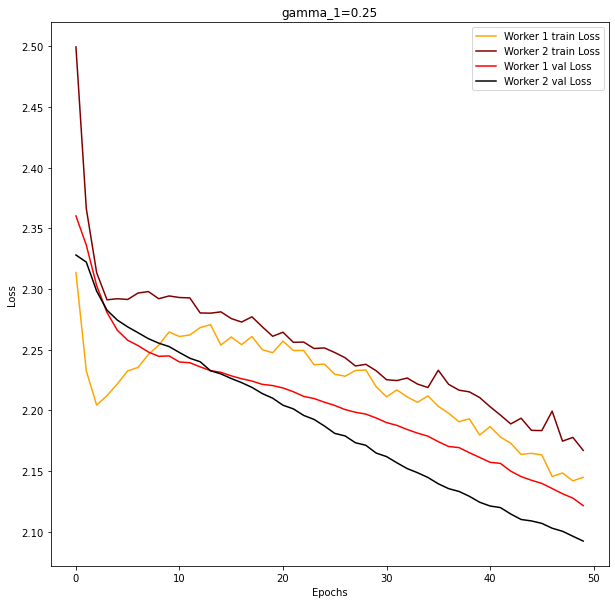

In [ ]:
path1='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8/training_process1.txt'
path2='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8/training_process2.txt'

plt.figure(figsize=(10, 10))
df1 = pd.read_csv(path1, sep="\t", header=None, names=names)
df2 = pd.read_csv(path2, sep="\t", header=None, names=names)

df1,df1_val,df2,df2_val=traindata(df1,df2)
print(df1.shape)
l1 = []
l2 = []
l1_val = []
l2_val = []
batchs=8
i=-1

for element1, element2 in zip(df1.loss, df2.loss):
  i+=1
  if i%batchs==0:
    ele1 = element1.split("(")
    ele2 = element2.split("(")
    ele1 = ele1[1].split(")")
    ele2 = ele2[1].split(")")
    l1.append(float(ele1[0]))
    l2.append(float(ele2[0]))

for element1_val, element2_val in zip(df1_val.loss, df2_val.loss):
  ele1_val = element1_val.split("(")
  ele2_val = element2_val.split("(")
  ele1_val = ele1_val[1].split(")")
  ele2_val = ele2_val[1].split(")")
  l1_val.append(float(ele1_val[0]))
  l2_val.append(float(ele2_val[0]))

plt.plot(l1, label = "Worker 1 train Loss",c='orange')
plt.plot(l2, label = "Worker 2 train Loss",c='maroon')
plt.plot(l1_val, label = "Worker 1 val Loss",c='red')
plt.plot(l2_val, label = "Worker 2 val Loss",c='black')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gamma_1=0.25")

Text(0.5, 1.0, 'gamma_1=0.25')

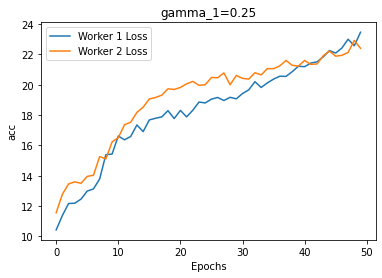

In [ ]:
path3='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8/accuracy_epoch1.txt'
path4='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8/accuracy_epoch2.txt'
#accuracy
df3 = pd.read_csv(path3, sep="\t", header=None, names = ["acc"])
df4 = pd.read_csv(path4, sep="\t", header=None, names = ["acc"])

l3 = []
l4 = []
for element3, element4 in zip(df3.acc, df4.acc):
  l3.append(element3)
  l4.append(element4)

plt.plot(l3, label = "Worker 1 Loss")
plt.plot(l4, label = "Worker 2 Loss")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("acc")
plt.title('gamma_1=0.25')

(1600, 5)


Text(0.5, 1.0, 'gamma_1=0.25')

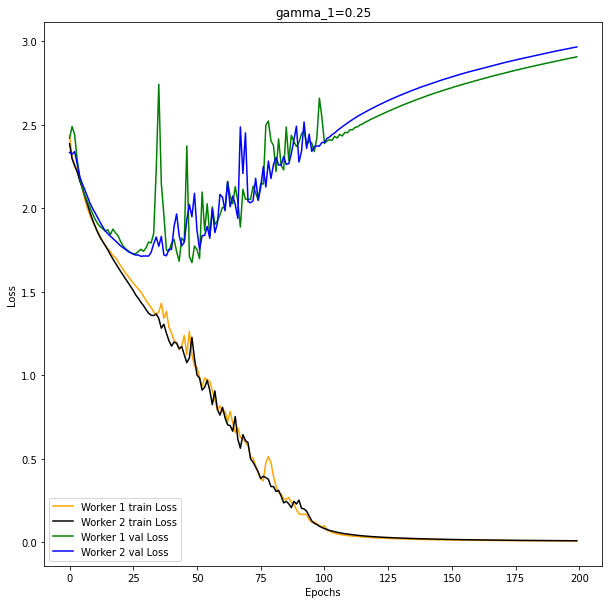

In [ ]:
path1='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.004/training_process1.txt'
path2='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.004/training_process2.txt'

plt.figure(figsize=(10, 10))
df1 = pd.read_csv(path1, sep="\t", header=None, names=names)
df2 = pd.read_csv(path2, sep="\t", header=None, names=names)

df1,df1_val,df2,df2_val=traindata(df1,df2)
print(df1.shape)
l1 = []
l2 = []
l1_val = []
l2_val = []
batchs=8
i=-1

for element1, element2 in zip(df1.loss, df2.loss):
  i+=1
  if i%batchs==0:
    ele1 = element1.split("(")
    ele2 = element2.split("(")
    ele1 = ele1[1].split(")")
    ele2 = ele2[1].split(")")
    l1.append(float(ele1[0]))
    l2.append(float(ele2[0]))

for element1_val, element2_val in zip(df1_val.loss, df2_val.loss):
  ele1_val = element1_val.split("(")
  ele2_val = element2_val.split("(")
  ele1_val = ele1_val[1].split(")")
  ele2_val = ele2_val[1].split(")")
  l1_val.append(float(ele1_val[0]))
  l2_val.append(float(ele2_val[0]))

plt.plot(l1, label = "Worker 1 train Loss",c='orange')
plt.plot(l2, label = "Worker 2 train Loss",c='black')
plt.plot(l1_val, label = "Worker 1 val Loss",c='green')
plt.plot(l2_val, label = "Worker 2 val Loss",c='blue')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gamma_1=0.25")

Text(0.5, 1.0, 'gamma_1=0.25')

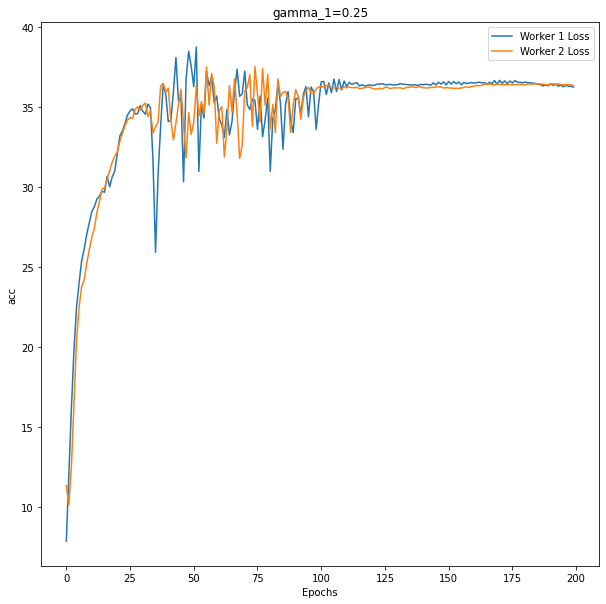

In [ ]:
path3='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.004/accuracy_epoch1.txt'
path4='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.004/accuracy_epoch2.txt'
#accuracy
df3 = pd.read_csv(path3, sep="\t", header=None, names = ["acc"])
df4 = pd.read_csv(path4, sep="\t", header=None, names = ["acc"])

l3 = []
l4 = []
for element3, element4 in zip(df3.acc, df4.acc):
  l3.append(element3)
  l4.append(element4)
plt.figure(figsize=(10, 10))
plt.plot(l3, label = "Worker 1 Loss")
plt.plot(l4, label = "Worker 2 Loss")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("acc")
plt.title('gamma_1=0.25')

(1200, 5)


Text(0.5, 1.0, 'gamma_1=0.25')

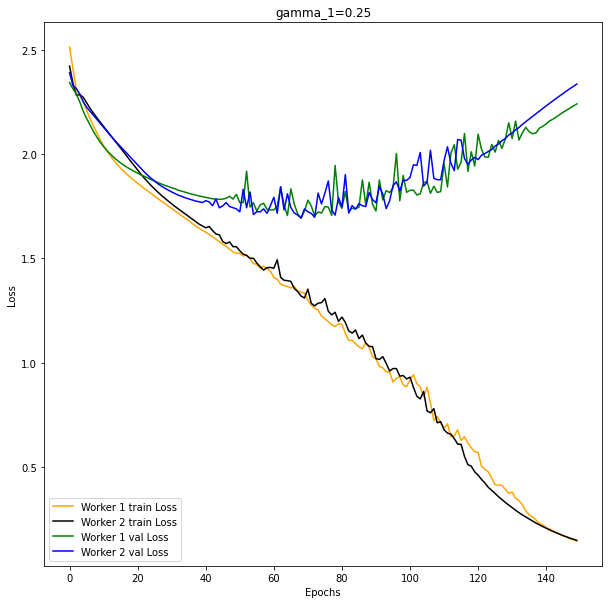

In [ ]:
path1='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_150_lr_0.002/training_process1.txt'
path2='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_150_lr_0.002/training_process2.txt'

plt.figure(figsize=(10, 10))
df1 = pd.read_csv(path1, sep="\t", header=None, names=names)
df2 = pd.read_csv(path2, sep="\t", header=None, names=names)

df1,df1_val,df2,df2_val=traindata(df1,df2)
print(df1.shape)
l1 = []
l2 = []
l1_val = []
l2_val = []
batchs=8
i=-1

for element1, element2 in zip(df1.loss, df2.loss):
  i+=1
  if i%batchs==0:
    ele1 = element1.split("(")
    ele2 = element2.split("(")
    ele1 = ele1[1].split(")")
    ele2 = ele2[1].split(")")
    l1.append(float(ele1[0]))
    l2.append(float(ele2[0]))

for element1_val, element2_val in zip(df1_val.loss, df2_val.loss):
  ele1_val = element1_val.split("(")
  ele2_val = element2_val.split("(")
  ele1_val = ele1_val[1].split(")")
  ele2_val = ele2_val[1].split(")")
  l1_val.append(float(ele1_val[0]))
  l2_val.append(float(ele2_val[0]))

plt.plot(l1, label = "Worker 1 train Loss",c='orange')
plt.plot(l2, label = "Worker 2 train Loss",c='black')
plt.plot(l1_val, label = "Worker 1 val Loss",c='green')
plt.plot(l2_val, label = "Worker 2 val Loss",c='blue')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gamma_1=0.25")

Text(0.5, 1.0, 'gamma_1=0.25')

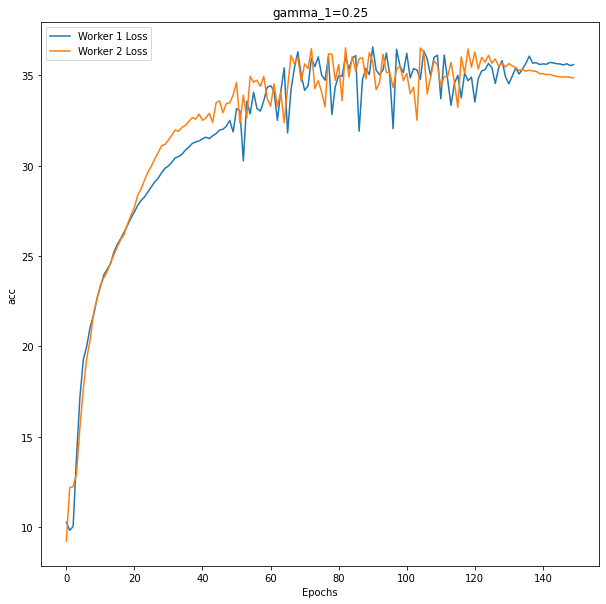

In [ ]:
path3='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_150_lr_0.002/accuracy_epoch1.txt'
path4='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_150_lr_0.002/accuracy_epoch2.txt'
#accuracy
df3 = pd.read_csv(path3, sep="\t", header=None, names = ["acc"])
df4 = pd.read_csv(path4, sep="\t", header=None, names = ["acc"])

l3 = []
l4 = []
for element3, element4 in zip(df3.acc, df4.acc):
  l3.append(element3)
  l4.append(element4)
plt.figure(figsize=(10, 10))
plt.plot(l3, label = "Worker 1 Loss")
plt.plot(l4, label = "Worker 2 Loss")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("acc")
plt.title('gamma_1=0.25')

## Multi Class

### LE COSINE

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 100 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_100.0_b_0.1
170499072it [00:04, 36625978.46it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (9000,) and unused (41000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 450
Label 2 samples = 450
Label 3 samples = 450
Label 4 samples = 450
Label 5 samples = 450
Label 6 samples = 450
Label 7 samples = 450
Label 8 samples = 450
Label 9 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 100 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_100.0_b_0.1
Files already downloaded and verified
Files already downloaded and verified
No of samples used (9000,) and unused (41000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 450
Label 2 samples = 450
Label 3 samples = 450
Label 4 samples = 450
Label 5 samples = 450
Label 6 samples = 450
Label 7 samples = 450
Label 8 samples = 450
Label 9 samples = 450
Label 10 samples = 450
Worker 2 Set:-
Label 1 samples = 450
Label 2 sampl

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8 

Streaming output truncated to the last 5000 lines.
Chunk 1 contrastive : 1.8190714077204604
Total Loss =  tensor(11.0142, device='cuda:0', grad_fn=<AddBackward0>)
W1 Epoch: [5][16/18]	Time 2.319 (2.346)	Loss 2.3883 (2.2941)	Prec@1 3.516 (9.766)	
W2 Epoch: [5][16/18]	Time 2.319 (2.346)	Loss 2.2293 (2.3138)	Prec@1 18.359 (9.009)	
+ve loss =  2.3022190338498376
-ve loss =  0.0
Chunk 1 contrastive : 2.3022190338498376
Total Loss =  tensor(10.9712, device='cuda:0', grad_fn=<AddBackward0>)
W1 Epoch: [5][17/18]	Time 2.294 (2.343)	Loss 2.3070 (2.2949)	Prec@1 9.375 (9.743)	
W2 Epoch: [5][17/18]	Time 2.294 (2.343)	Loss 2.1647 (2.3050)	Prec@1 30.859 (10.294)	
+ve loss =  2.0485424422452687
-ve loss =  0.0
Chunk 1 contrastive : 2.0485424422452687
Total Loss =  tensor(10.3783, device='cuda:0', grad_fn=<AddBackward0>)
W1 Epoch: [5][18/18]	Time 0.843 (2.260)	Loss 2.3043 (2.2952)	Prec@1 7.432 (9.667)	
W2 Epoch: [5][18/18]	Time 0.843 (2.260)	Loss 2.1685 (2.3005)	Prec@1 32.432 (11.022)	
W1 Val: [5][10/1

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8
Files already downloaded and verified
Files already downloaded and verified
No of samples used (9000,) and unused (41000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 450
Label 2 samples = 450
Label 3 samples = 450
Label 4 samples = 450
Label 5 samples = 450
Label 6 samples = 450
Label 7 samples = 450
Label 8 samples = 450
Label 9 samples = 450
Label 10 samples = 450
Worker 2 Set:-
Label 1 samples = 450
Label 2 samples

### DISTANCE

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 0.1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_0.1
170499072it [00:02, 60726666.73it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (9000,) and unused (41000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 450
Label 2 samples = 450
Label 3 samples = 450
Label 4 samples = 450
Label 5 samples = 450
Label 6 samples = 450
Label 7 samples = 450
Label 8 samples = 450
Label 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0_exp
170499072it [00:03, 49164314.16it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
La

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sam

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sam

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 2.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_2.0_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sam

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.5_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sam

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.25 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.25_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sa

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "amc" --contrastive_loss_margin 0.6 --negative_weight 1000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/amc/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_0.0_skewness_rate_0.5_m_0.6_a_1000.0_b_1.0
170499072it [00:09, 17978952.15it/s]                   
Extracting /content/images/cifar-10-python.tar.gz to /content/images
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samp

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.75 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "distance" --contrastive_loss_margin 1.5 --negative_weight 10000 --positive_weight 1 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/distance/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.75_gamma_2_1.0_skewness_rate_0.5_m_1.5_a_10000.0_b_1.0
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 sa

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8 

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/2_models/multi_class/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_1.0_gamma_2_1.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2 samples

## Finding a Good Baseline

##### CIFAR10

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --cos_lr --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.001
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_200_lr_0.004
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data.py --dataset cifar10 --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "lecosine" --negative_weight 0 --positive_weight 0.8

/usr/local/lib/python3.7/dist-packages/kornia/augmentation/augmentation.py:1833: DeprecationWarning: GaussianBlur is no longer maintained and will be removed from the future versions. Please use RandomGaussianBlur instead.
  category=DeprecationWarning,
Storing in ... ./InfoPro_cifar10_resnet16_K_2_/baseline/cifar10/lecosine/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_skewness_rate_0.5_m_0.5_a_0.0_b_0.8_epochs_150_lr_0.002
Files already downloaded and verified
Files already downloaded and verified
No of samples used (2000,) and unused (48000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 100
Label 2 samples = 100
Label 3 samples = 100
Label 4 samples = 100
Label 5 samples = 100
Label 6 samples = 100
Label 7 samples = 100
Label 8 samples = 100
Label 9 samples = 100
Label 10 samples = 100
Worker 2 Set:-
Label 1 samples = 100
Label 2

##### FMNIST v1.0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_1.0_margin_1.5_a_500.0_b_1.8_skewness_rate_0.5_epochs_60
26422272it [00:02, 11944871.99it/s]                 
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 203275.23it/s]              
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:01, 3749639.94it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 25847345.81it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

Processing...
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:502: UserWarning:

In [ ]:
path1='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.5_a_0.0_b_0.8_skewness_rate_0.5_epochs_200/training_process1.txt'
path2='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.5_a_0.0_b_0.8_skewness_rate_0.5_epochs_200/training_process2.txt'

plt.figure(figsize=(10, 10))
df1 = pd.read_csv(path1, sep="\t", header=None, names=names)
df2 = pd.read_csv(path2, sep="\t", header=None, names=names)

print('no of samples ', df1.shape)
ts = int(5*df1.shape[0]/8)
df1 = df1.iloc[ts:, :]
df2 = df2.iloc[ts:, :]
df1,df1_val,df2,df2_val=traindata(df1,df2)
print(df1.shape)
l1 = []
l2 = []
l1_val = []
l2_val = []
batchs=2
i=-1

for element1, element2 in zip(df1.loss, df2.loss):
  i+=1
  if i%batchs==0:
    ele1 = element1.split("(")
    ele2 = element2.split("(")
    ele1 = ele1[1].split(")")
    ele2 = ele2[1].split(")")
    l1.append(float(ele1[0]))
    l2.append(float(ele2[0]))

for element1_val, element2_val in zip(df1_val.loss, df2_val.loss):
  ele1_val = element1_val.split("(")
  ele2_val = element2_val.split("(")
  ele1_val = ele1_val[1].split(")")
  ele2_val = ele2_val[1].split(")")
  l1_val.append(float(ele1_val[0]))
  l2_val.append(float(ele2_val[0]))

plt.plot(l1, label = "Worker 1 train Loss",c='orange')
plt.plot(l2, label = "Worker 2 train Loss",c='black')
plt.plot(l1_val, label = "Worker 1 val Loss",c='green')
plt.plot(l2_val, label = "Worker 2 val Loss",c='blue')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gamma_1=0.25")

In [ ]:
path3='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.5_a_0.0_b_0.8_skewness_rate_0.5_epochs_200/accuracy_epoch1.txt'
path4='/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.5_a_0.0_b_0.8_skewness_rate_0.5_epochs_200/accuracy_epoch2.txt'
#accuracy
df3 = pd.read_csv(path3, sep="\t", header=None, names = ["acc"])
df4 = pd.read_csv(path4, sep="\t", header=None, names = ["acc"])

l3 = []
l4 = []
for element3, element4 in zip(df3.acc, df4.acc):
  l3.append(element3)
  l4.append(element4)
plt.figure(figsize=(10, 10))
plt.plot(l3, label = "Worker 1 Val Acc")
plt.plot(l4, label = "Worker 2 Val Acc")
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("acc")
plt.title('gamma_1=0.25')

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
-ve loss =  3.821236380515833
+ve loss =  0.35599706742559123
-ve loss =  3.842409949442354
+ve loss =  0.36685029593439267
-ve loss =  1.196426077896278
+ve loss =  0.3884333080772558
-ve loss =  7.5574647800411725
+ve loss =  0.33812304083873623
-ve loss =  1.9800926337668858
+ve loss =  0.3849680825991837
-ve loss =  4.279336311649937
+ve loss =  0.3674895165845035
-ve loss =  1.4142777387316077
+ve loss =  0.3896601393222168
-ve loss =  5.216013645171094
+ve loss =  0.34663769609983874
W1 Epoch: [10][2/2]	Time 9.887 (10.423)	Loss 0.7736 (0.8018)	Prec@1 71.311 (69.600)	
W2 Epoch: [10][2/2]	Time 9.887 (10.423)	Loss 0.6749 (0.6558)	Prec@1 78.689 (78.800)	
W3 Epoch: [10][2/2]	Time 9.887 (10.423)	Loss 0.7011 (0.7959)	Prec@1 73.770 (70.800)	
W4 Epoch: [10][2/2]	Time 9.887 (10.423)	Loss 0.5886 (0.6323)	Prec@1 73.770 (74.800)	
W5 Epoch: [10][2/2]	Time 9.887 (10.423)	Loss 0.8187 (0.9091)	Prec@1 72.131 (67.600)	
W1 Val: [10][10/10]	Time 0.27

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_0.0_margin_1.5_a_500.0_b_1.8_skewness_rate_0.5_epochs_60
No of samples used (1000,) and unused (59000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 2 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 3 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 5 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_5/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_0.0_margin_1.5_a_500.0_b_1.8_skewness_rate_0.5_epochs_60
No of samples used (1250,) and unused (58750,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 2 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 3 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label

In [ ]:
st = time.time()

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.5_gamma_2_1.0_margin_1.5_a_500.0_b_1.8_skewness_rate_0.5_epochs_60
No of samples used (1000,) and unused (59000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 2 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 3 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label

In [ ]:
print(time.time()-st)
st=time.time()

1426.4210250377655


In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 500.0 --positive_weight 1.8 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
-ve loss =  2.04139523402365
+ve loss =  0.3793435609074762
-ve loss =  8.447915179471245
+ve loss =  0.3470859772606071
-ve loss =  5.139652037934506
+ve loss =  0.35305423136841574
-ve loss =  9.30462790829813
+ve loss =  0.337513994946335
-ve loss =  0.7410817042501727
+ve loss =  0.3923115911486328
-ve loss =  3.6181557790402024
+ve loss =  0.3736130732613461
-ve loss =  4.817813995287515
+ve loss =  0.3464536359828507
-ve loss =  4.812570196170699
+ve loss =  0.349272584287238
W1 Epoch: [10][2/2]	Time 9.890 (10.342)	Loss 0.8709 (0.8606)	Prec@1 73.770 (70.800)	
W2 Epoch: [10][2/2]	Time 9.890 (10.342)	Loss 0.9424 (0.8592)	Prec@1 67.213 (68.800)	
W3 Epoch: [10][2/2]	Time 9.890 (10.342)	Loss 0.7664 (0.8008)	Prec@1 68.852 (67.200)	
W4 Epoch: [10][2/2]	Time 9.890 (10.342)	Loss 0.6362 (0.6805)	Prec@1 77.869 (76.000)	
W5 Epoch: [10][2/2]	Time 9.890 (10.342)	Loss 0.7795 (0.7889)	Prec@1 72.951 (75.200)	
W1 Val: [10][10/10]	Time 0.283 (0.361

In [ ]:
print(time.time()-st)

1770.4015288352966


In [ ]:
st=time.time()

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 100.0 --positive_weight 1.8 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.5_gamma_2_1.0_margin_1.5_a_100.0_b_1.8_skewness_rate_0.5_epochs_60
No of samples used (1000,) and unused (59000,)
No of samples used (10000,) and unused (0,)
Worker 1 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 2 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label 8 samples = 25
Label 9 samples = 25
Label 10 samples = 25
Worker 3 Set:-
Label 1 samples = 25
Label 2 samples = 25
Label 3 samples = 25
Label 4 samples = 25
Label 5 samples = 25
Label 6 samples = 25
Label 7 samples = 25
Label

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.5 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 100.0 --positive_weight 1.8 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
-ve loss =  0.99844026552737
+ve loss =  0.34988688566581566
-ve loss =  0.8849271360631593
+ve loss =  0.3693604401381097
-ve loss =  0.28879800748837886
+ve loss =  0.3831818668536684
-ve loss =  0.7769871962643925
+ve loss =  0.3464459594300087
-ve loss =  5.091063600174684
+ve loss =  0.28691293398112067
W1 Epoch: [10][2/2]	Time 9.826 (10.305)	Loss 0.7583 (0.7890)	Prec@1 77.049 (71.200)	
W2 Epoch: [10][2/2]	Time 9.826 (10.305)	Loss 0.8996 (0.8251)	Prec@1 66.393 (68.800)	
W3 Epoch: [10][2/2]	Time 9.826 (10.305)	Loss 0.8216 (0.7385)	Prec@1 72.951 (76.000)	
W4 Epoch: [10][2/2]	Time 9.826 (10.305)	Loss 0.7514 (0.6910)	Prec@1 74.590 (76.800)	
W5 Epoch: [10][2/2]	Time 9.826 (10.305)	Loss 0.9588 (0.8919)	Prec@1 59.836 (66.800)	
W1 Val: [10][10/10]	Time 0.293 (0.369)	Loss 22.8274 (23.8923)	Prec@1 0.000 (10.020)	
W2 Val: [10][10/10]	Time 0.293 (0.369)	Loss 20.9762 (12.8055)	Prec@1 0.128 (16.310)	
W3 Val: [10][10/10]	Time 0.293 (0.369)	Loss 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.91 --gamma_2 1.33 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --negative_weight 100.0 --positive_weight 1.8 --workers 4 --epoch 5

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.91_gamma_2_1.33_margin_1.5_a_100.0_b_1.8_skewness_rate_0.5_epochs_5
26422272it [00:02, 10488884.96it/s]                 
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 202538.11it/s]              
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:01, 3789905.17it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 25641595.80it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

Processing...
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:502: UserWarning

##### FMNIST v2.0
Corrected Checkpoint code

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(8.0852, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(6.5391, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(6.5757, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(6.6158, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(6.6511, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda:0', grad_fn=<SubBackward0>) Other Losses =  tensor(6.6511, device='cuda:0', grad_fn=<AddBackward0>)
Contrastive Loss Added =  tensor(0., device='cuda

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 7 --epoch 60

Streaming output truncated to the last 5000 lines.
W7 Epoch: [36][1/2]	Time 11.787 (11.787)	Loss 0.1049 (0.1049)	Prec@1 96.875 (96.875)	
-ve loss =  0.0
+ve loss =  0.19009290334839424
-ve loss =  0.0
+ve loss =  0.21409636868869256
-ve loss =  0.0
+ve loss =  0.1967533299180328
-ve loss =  0.0
+ve loss =  0.21055262257289706
-ve loss =  0.0
+ve loss =  0.2114412163701374
-ve loss =  0.0
+ve loss =  0.20773864106381013
-ve loss =  0.0
+ve loss =  0.1808449863842885
-ve loss =  0.0
+ve loss =  0.20749681324639713
-ve loss =  0.0
+ve loss =  0.19580826096815374
-ve loss =  0.0
+ve loss =  0.19720632855016293
-ve loss =  0.0
+ve loss =  0.19817096614863275
-ve loss =  0.0
+ve loss =  0.19483225616643712
-ve loss =  0.0
+ve loss =  0.18708743449341575
-ve loss =  0.0
+ve loss =  0.2060892319877889
-ve loss =  0.0
+ve loss =  0.2137770700185602
-ve loss =  0.0
+ve loss =  0.19308462658097622
-ve loss =  0.0
+ve loss =  0.20588900190116063
-ve loss =  0.0
+ve loss =  0.18812419560224067
-ve 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
+ve loss =  0.2009028839956077
-ve loss =  0.0
+ve loss =  0.2111915971796476
Contrastive Loss Added =  0.0 Other Losses =  7.0118794441223145
Contrastive Loss Added =  0.04330635070800781 Other Losses =  7.0118794441223145
Contrastive Loss Added =  0.03925037384033203 Other Losses =  7.055185794830322
Contrastive Loss Added =  0.03898429870605469 Other Losses =  7.094436168670654
Contrastive Loss Added =  0.035649776458740234 Other Losses =  7.133420467376709
Contrastive Loss Added =  0.036911964416503906 Other Losses =  7.169070243835449
Contrastive Loss Added =  0.04330635070800781 Other Losses =  6.48799991607666
Contrastive Loss Added =  0.0 Other Losses =  6.531306266784668
Contrastive Loss Added =  0.037068843841552734 Other Losses =  6.531306266784668
Contrastive Loss Added =  0.04124736785888672 Other Losses =  6.568375110626221
Contrastive Loss Added =  0.040738582611083984 Other Losses =  6.609622478485107
Contrastive Loss A

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 7 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  0.03337430953979492 Other Losses =  6.731411933898926
Contrastive Loss Added =  0.034212589263916016 Other Losses =  6.764786243438721
Contrastive Loss Added =  0.03355264663696289 Other Losses =  6.798998832702637
Contrastive Loss Added =  0.036896705627441406 Other Losses =  6.8325514793396
Contrastive Loss Added =  0.02996969223022461 Other Losses =  6.297637939453125
Contrastive Loss Added =  0.03305196762084961 Other Losses =  6.32760763168335
Contrastive Loss Added =  0.0 Other Losses =  6.360659599304199
Contrastive Loss Added =  0.030282020568847656 Other Losses =  6.360659599304199
Contrastive Loss Added =  0.03202056884765625 Other Losses =  6.390941619873047
Contrastive Loss Added =  0.033100128173828125 Other Losses =  6.422962188720703
Contrastive Loss Added =  0.03207206726074219 Other Losses =  6.456062316894531
Contrastive Loss Added =  0.030880451202392578 Other Losses =  6.5191497802734375
Co

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  0.039537906646728516 Other Losses =  6.814610958099365
Contrastive Loss Added =  0.040350914001464844 Other Losses =  6.929470539093018
Contrastive Loss Added =  0.0382533073425293 Other Losses =  6.969821453094482
Contrastive Loss Added =  0.03912210464477539 Other Losses =  7.008074760437012
Contrastive Loss Added =  0.040730953216552734 Other Losses =  7.047196865081787
Contrastive Loss Added =  0.0 Other Losses =  7.08792781829834
Contrastive Loss Added =  0.03792762756347656 Other Losses =  7.08792781829834
Contrastive Loss Added =  0.04289436340332031 Other Losses =  6.290617942810059
Contrastive Loss Added =  0.03625297546386719 Other Losses =  6.333512306213379
Contrastive Loss Added =  0.04178905487060547 Other Losses =  6.369765281677246
Contrastive Loss Added =  0.039537906646728516 Other Losses =  6.411554336547852
Contrastive Loss Added =  0.03792762756347656 Other Losses =  6.45109224319458
Contr

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 1.0 --workers 7 --epoch 60

Streaming output truncated to the last 5000 lines.
W7 Epoch: [36][1/2]	Time 15.390 (15.390)	Loss 0.1440 (0.1440)	Prec@1 94.531 (94.531)	
-ve loss =  0.0
+ve loss =  0.1986638238051347
-ve loss =  0.0
+ve loss =  0.19917132924302103
-ve loss =  0.0
+ve loss =  0.19739709416886422
-ve loss =  0.0
+ve loss =  0.20468696526576358
-ve loss =  0.0
+ve loss =  0.20066486164883432
-ve loss =  0.0
+ve loss =  0.21641162030641126
-ve loss =  0.0
+ve loss =  0.18252695519832537
-ve loss =  0.0
+ve loss =  0.1964399526914388
-ve loss =  0.0
+ve loss =  0.19506307764419847
-ve loss =  0.0
+ve loss =  0.20099934939574376
-ve loss =  0.0
+ve loss =  0.19647976250713853
-ve loss =  0.0
+ve loss =  0.19225846218569437
-ve loss =  0.0
+ve loss =  0.2038134293221748
-ve loss =  0.0
+ve loss =  0.20526841493487133
-ve loss =  0.0
+ve loss =  0.20964098271424011
-ve loss =  0.0
+ve loss =  0.20734954809380038
-ve loss =  0.0
+ve loss =  0.20702586985185434
-ve loss =  0.0
+ve loss =  0.18852688656863076
-v

In [ ]:
df=pd.read_csv('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/pos_neg_dist_exp.csv', header=None)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54316 entries, 0 to 54315
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       54316 non-null  float64
 1   1       54316 non-null  float64
dtypes: float64(2)
memory usage: 848.8 KB


In [ ]:
df1=df.iloc[-2520:, :]
df1

,0,1
51796,0.0,0.193950
51797,0.0,0.194939
51798,0.0,0.202651
51799,0.0,0.202008
51800,0.0,0.202032
...,...,...
54311,0.0,0.206384
54312,0.0,0.190474
54313,0.0,0.201822
54314,0.0,0.206108


In [ ]:
p = df1.iloc[:,1]
n = df1.iloc[:,0]
p_np = np.array(p)
n_np = np.array(n)

In [ ]:
avg_p = []
for i in range(0, len(p_np),2):
  avg_p.append((p_np[i]+p_np[i+1])/2)


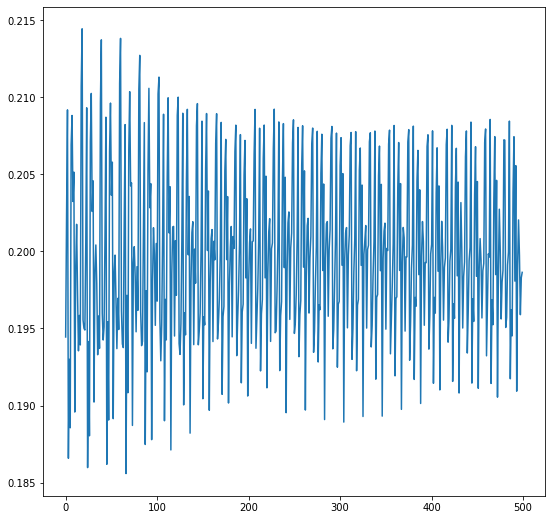

In [ ]:
plt.figure(figsize=(9,9))
plt.plot(avg_p[:500])
plt.show()

#### fmnist v3.0
Ramp up down weights

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "amc" --contrastive_loss_margin 0.5 --negative_weight 1.0 --positive_weight 1.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/amc/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_0.5_a_1.0_b_1.0_skewness_rate_0.5_epochs_60
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0,)
Worker 1 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0,)
Wo

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 10.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_10.0_skewness_rate_0.5_epochs_60
26422272it [00:04, 6292664.89it/s]                  
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 57172.31it/s]               
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:02, 2151756.77it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 11947057.85it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWar

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0,)
Wo

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 3 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_3/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60
26422272it [00:01, 18482119.79it/s]                 
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 333741.65it/s]
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:00, 6059062.01it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 21746669.85it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The giv

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (1000,) and unused (59000,)
No of samples used (10000,) and unused (0,)
W

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  0.0 Other Losses =  7.147263050079346
Contrastive Loss Added =  4.516556262969971 Other Losses =  7.147263050079346
Contrastive Loss Added =  5.209094047546387 Other Losses =  11.663819313049316
Contrastive Loss Added =  5.609565734863281 Other Losses =  16.872913360595703
Contrastive Loss Added =  4.953668594360352 Other Losses =  22.482479095458984
Contrastive Loss Added =  4.516556262969971 Other Losses =  7.321043491363525
Contrastive Loss Added =  0.0 Other Losses =  11.837599754333496
Contrastive Loss Added =  4.841498374938965 Other Losses =  11.837599754333496
Contrastive Loss Added =  4.875675201416016 Other Losses =  16.67909812927246
Contrastive Loss Added =  5.475130081176758 Other Losses =  21.554773330688477
Contrastive Loss Added =  5.209092617034912 Other Losses =  7.277164936065674
Contrastive Loss Added =  4.841497421264648 Other Losses =  12.486257553100586
Contrastive Loss Added =  0.0 Othe

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  4.251987457275391 Other Losses =  22.677030563354492
Contrastive Loss Added =  4.057322978973389 Other Losses =  6.8826375007629395
Contrastive Loss Added =  4.371170997619629 Other Losses =  10.939960479736328
Contrastive Loss Added =  3.49741268157959 Other Losses =  15.311131477355957
Contrastive Loss Added =  4.102012634277344 Other Losses =  18.808544158935547
Contrastive Loss Added =  0.0 Other Losses =  22.91055679321289
Contrastive Loss Added =  3.1754074096679688 Other Losses =  22.91055679321289
Contrastive Loss Added =  4.386300086975098 Other Losses =  6.590785980224609
Contrastive Loss Added =  4.139496803283691 Other Losses =  10.977086067199707
Contrastive Loss Added =  4.199884414672852 Other Losses =  15.116582870483398
Contrastive Loss Added =  4.251987457275391 Other Losses =  19.31646728515625
Contrastive Loss Added =  3.1754074096679688 Other Losses =  23.56845474243164
Contrastive Loss Ad

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 3 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_3/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (750,) and unused (59250,)
No of samples used (10000,) and unused (0,)
Wo

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 4 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  6.350442886352539 Other Losses =  27.02375602722168
Contrastive Loss Added =  6.5071258544921875 Other Losses =  33.37419891357422
Contrastive Loss Added =  6.8724365234375 Other Losses =  39.881324768066406
Contrastive Loss Added =  0.0 Other Losses =  46.753761291503906
W1 Epoch: [21][1/2]	Time 6.464 (6.464)	Loss 0.2450 (0.2450)	Prec@1 91.406 (91.406)	
W2 Epoch: [21][1/2]	Time 6.464 (6.464)	Loss 0.2558 (0.2558)	Prec@1 90.625 (90.625)	
W3 Epoch: [21][1/2]	Time 6.464 (6.464)	Loss 0.4732 (0.4732)	Prec@1 82.031 (82.031)	
W4 Epoch: [21][1/2]	Time 6.464 (6.464)	Loss 0.2249 (0.2249)	Prec@1 93.750 (93.750)	
-ve loss =  0.0
+ve loss =  20.90981126440305
-ve loss =  0.0
+ve loss =  19.909197205787255
-ve loss =  0.0
+ve loss =  21.113362936395625
-ve loss =  0.0
+ve loss =  19.16621350947326
-ve loss =  0.0
+ve loss =  20.870867521331633
-ve loss =  0.0
+ve loss =  20.74124859853702
Contrastive Loss Added =  0.0 Other

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
+ve loss =  18.420007824897766
-ve loss =  0.0
+ve loss =  18.350660800933838
-ve loss =  0.0
+ve loss =  20.86361199617386
-ve loss =  0.0
+ve loss =  23.557859659194946
-ve loss =  0.0
+ve loss =  20.060165226459503
-ve loss =  0.0
+ve loss =  21.983598172664642
-ve loss =  0.0
+ve loss =  20.638494193553925
-ve loss =  0.0
+ve loss =  22.048872709274292
Contrastive Loss Added =  0.0 Other Losses =  23.069168090820312
Contrastive Loss Added =  3.992757797241211 Other Losses =  23.069168090820312
Contrastive Loss Added =  4.007846832275391 Other Losses =  27.061925888061523
Contrastive Loss Added =  4.510286331176758 Other Losses =  31.069772720336914
Contrastive Loss Added =  4.774169921875 Other Losses =  35.58005905151367
Contrastive Loss Added =  3.992757797241211 Other Losses =  23.618051528930664
Contrastive Loss Added =  0.0 Other Losses =  27.610809326171875
Contrastive Loss Added =  4.364715576171875 Other Losses =  27.610809

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
+ve loss =  19.89660142602795
-ve loss =  0.0
+ve loss =  20.06686835223646
Contrastive Loss Added =  0.0 Other Losses =  15.728354454040527
Contrastive Loss Added =  1.8053808212280273 Other Losses =  15.728354454040527
Contrastive Loss Added =  1.8884544372558594 Other Losses =  17.533735275268555
Contrastive Loss Added =  1.9933090209960938 Other Losses =  19.422189712524414
Contrastive Loss Added =  1.9842700958251953 Other Losses =  21.415498733520508
Contrastive Loss Added =  1.8058662414550781 Other Losses =  23.399768829345703
Contrastive Loss Added =  1.8053817749023438 Other Losses =  14.72941780090332
Contrastive Loss Added =  0.0 Other Losses =  16.534799575805664
Contrastive Loss Added =  1.8142776489257812 Other Losses =  16.534799575805664
Contrastive Loss Added =  1.656280517578125 Other Losses =  18.349077224731445
Contrastive Loss Added =  1.9283103942871094 Other Losses =  20.00535774230957
Contrastive Loss Added =  

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run2
26422272it [00:01, 17741215.74it/s]                 
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 332268.18it/s]
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:00, 6179837.88it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 23153462.51it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: Th

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run3
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run2
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run3
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 1.0 --workers 1 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_1/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.0_a_1.0_b_1.0_skewness_rate_0.5_epochs_60_run3
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (250,) and unused (59750,)
No of samples used (10000,) and unused (0,)

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run1
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run2
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 2 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_1.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run3
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (500,) and unused (59500,)
No of samples used (10000,) and unused (0

#### Using t-SNE for visualizing clusters

In [ ]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from networks.resnet import resnet16
import torchvision
from torchvision import transforms

normalize = transforms.Normalize(mean=[x / 255 for x in [127.5, 127.5, 127.5]],
                                         std=[x / 255 for x in [127.5, 127.5, 127.5]])
transform_fn = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((32,32)),
            transforms.Lambda(lambda x: x.repeat(3, 1, 1)),
            normalize,
            ])
fmnist = torchvision.datasets.FashionMNIST(root="/content/images/", download = True, train=True, transform = transform_fn)


Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw




Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw




Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw




Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [ ]:
idx = []
idx1,idx2,idx3 = [],[],[]
for i in range(15000):
  if fmnist[i][1] == 0:
    idx1.append(i)
  if fmnist[i][1] == 1:
    idx2.append(i)
  if fmnist[i][1] == 2:
    idx3.append(i)

idx = idx1[:1000]+idx2[:1000]+idx3[:1000]

In [ ]:
test_batch = torch.utils.data.DataLoader(fmnist, batch_size=128, sampler=idx)

1 worker

In [ ]:
nocolab_worker1 = resnet16(local_module_num=2, batch_size=128)

2 workers

In [ ]:
colab_worker1 = resnet16(local_module_num=2, batch_size=128)
colab_worker2 = resnet16(local_module_num=2, batch_size=128)

In [ ]:
cw1c = torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_10.0_skewness_rate_0.5_epochs_60/checkpoint_0/model_best.pth.tar')
cw2c = torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_2/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_10.0_skewness_rate_0.5_epochs_60/checkpoint_1/model_best.pth.tar')

In [ ]:
ncw1 = torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/worker_1/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_cos_lr__gamma_1_0.0_gamma_2_0.0_margin_1.0_a_100.0_b_1.0_skewness_rate_0.3333333333333333_epochs_60/checkpoint_0/model_best.pth.tar', map_location=torch.device('cpu'))

In [ ]:
colab_worker1.load_state_dict(cw1c['state_dict'])
colab_worker2.load_state_dict(cw2c['state_dict'])

<All keys matched successfully>

In [ ]:
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in ncw1['state_dict'].items():
    name = k[7:] # remove `module.`
    new_state_dict[name] = v
nocolab_worker1.load_state_dict(new_state_dict)

<All keys matched successfully>

In [ ]:
h1,h2 = np.array([]), np.array([])
for (img, target) in test_batch:
  _,_,_,_,w1h2 = colab_worker1(img, target, 5,1,1,0,0,0,1)
  _,_,_,_,w2h2 = colab_worker2(img, target, 5,1,1,0,0,0,1)
  if h1.size == 0:
    h1 = w1h2.detach().numpy()
    h2 = w2h2.detach().numpy()
    continue
  h1 = np.append(h1, w1h2.detach().numpy(), axis=0)
  h2 = np.append(h2, w2h2.detach().numpy(), axis=0)

In [ ]:
nh1 = np.array([])
for (img, target) in test_batch:
  _,_,_,_,nw1h2 = nocolab_worker1(img, target, 5,1,1,0,0,0,1)
  if nh1.size == 0:
    nh1 = nw1h2.detach().numpy()
    continue
  nh1 = np.append(nh1, nw1h2.detach().numpy(), axis=0)

In [ ]:
h1.shape, h2.shape

((3000, 128), (3000, 128))

4 workers case

In [ ]:
colab_worker1 = resnet16(local_module_num=2, batch_size=128)
colab_worker2 = resnet16(local_module_num=2, batch_size=128)
colab_worker3 = resnet16(local_module_num=2, batch_size=128)
colab_worker4 = resnet16(local_module_num=2, batch_size=128)

In [ ]:
cw1=torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60/checkpoint_0/model_best.pth.tar', map_location=torch.device('cpu'))
cw2=torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60/checkpoint_1/model_best.pth.tar', map_location=torch.device('cpu'))
cw3=torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60/checkpoint_2/model_best.pth.tar', map_location=torch.device('cpu'))
cw4=torch.load('/content/gdrive/Shareddrives/Disk1/InfoPro-Pytorch/Experiments on CIFAR-SVHN-STL10/InfoPro_fmnist_resnet16_K_2_/multiworker/rampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60/checkpoint_3/model_best.pth.tar', map_location=torch.device('cpu'))

In [ ]:
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in cw1['state_dict'].items():
    name = k[7:] # remove `module.`
    new_state_dict[name] = v
colab_worker1.load_state_dict(new_state_dict)

<All keys matched successfully>

In [ ]:
new_state_dict = OrderedDict()
for k, v in cw2['state_dict'].items():
    name = k[7:] # remove `module.`
    new_state_dict[name] = v
colab_worker2.load_state_dict(new_state_dict)
new_state_dict = OrderedDict()
for k, v in cw3['state_dict'].items():
    name = k[7:] # remove `module.`
    new_state_dict[name] = v
colab_worker3.load_state_dict(new_state_dict)
new_state_dict = OrderedDict()
for k, v in cw4['state_dict'].items():
    name = k[7:] # remove `module.`
    new_state_dict[name] = v
colab_worker4.load_state_dict(new_state_dict)

<All keys matched successfully>

In [ ]:
h1,h2 = np.array([]), np.array([])
h3,h4 = np.array([]), np.array([])

for (img, target) in test_batch:
  _,_,_,_,w1h2 = colab_worker1(img, target, 5,1,1,0,0,0,1)
  _,_,_,_,w2h2 = colab_worker2(img, target, 5,1,1,0,0,0,1)
  _,_,_,_,w3h2 = colab_worker3(img, target, 5,1,1,0,0,0,1)
  _,_,_,_,w4h2 = colab_worker4(img, target, 5,1,1,0,0,0,1)
  
  if h1.size == 0:
    h1 = w1h2.detach().numpy()
    h2 = w2h2.detach().numpy()
    h3 = w3h2.detach().numpy()
    h4 = w4h2.detach().numpy()
    continue
  h1 = np.append(h1, w1h2.detach().numpy(), axis=0)
  h2 = np.append(h2, w2h2.detach().numpy(), axis=0)
  h3 = np.append(h3, w3h2.detach().numpy(), axis=0)
  h4 = np.append(h4, w4h2.detach().numpy(), axis=0)

In [ ]:
w1_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w1_pca = PCA(n_components=50)

w1_pca_result = w1_pca.fit_transform(h1)
w1_tsne = w1_tsne_fn.fit_transform(w1_pca_result)

w2_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w2_pca = PCA(n_components=50)

w2_pca_result = w2_pca.fit_transform(h2)
w2_tsne = w2_tsne_fn.fit_transform(w2_pca_result)

w3_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w3_pca = PCA(n_components=50)

w3_pca_result = w3_pca.fit_transform(h3)
w3_tsne = w3_tsne_fn.fit_transform(w3_pca_result)

w4_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w4_pca = PCA(n_components=50)

w4_pca_result = w4_pca.fit_transform(h4)
w4_tsne = w4_tsne_fn.fit_transform(w4_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.037s...
[t-SNE] Computed neighbors for 3000 samples in 0.851s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.368403
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.152458
[t-SNE] KL divergence after 300 iterations: 1.989749
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.034s...
[t-SNE] Computed neighbors for 3000 samples in 0.653s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.389692
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.824135
[t-SNE] KL divergence after 300 iterations: 1.807423


In [ ]:
h1.shape, h2.shape, h3.shape, h4.shape

((3000, 128), (3000, 128), (3000, 128), (3000, 128))

In [ ]:
cw_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
cw_pca = PCA(n_components=50)
h = np.append(h1, h2, axis=0)
h = np.append(h, h3, axis=0)
h = np.append(h, h4, axis=0)

cw_pca_result = cw_pca.fit_transform(h)
cw_tsne = cw_tsne_fn.fit_transform(cw_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 12000 samples in 0.127s...
[t-SNE] Computed neighbors for 12000 samples in 3.343s...
[t-SNE] Computed conditional probabilities for sample 1000 / 12000
[t-SNE] Computed conditional probabilities for sample 2000 / 12000
[t-SNE] Computed conditional probabilities for sample 3000 / 12000
[t-SNE] Computed conditional probabilities for sample 4000 / 12000
[t-SNE] Computed conditional probabilities for sample 5000 / 12000
[t-SNE] Computed conditional probabilities for sample 6000 / 12000
[t-SNE] Computed conditional probabilities for sample 7000 / 12000
[t-SNE] Computed conditional probabilities for sample 8000 / 12000
[t-SNE] Computed conditional probabilities for sample 9000 / 12000
[t-SNE] Computed conditional probabilities for sample 10000 / 12000
[t-SNE] Computed conditional probabilities for sample 11000 / 12000
[t-SNE] Computed conditional probabilities for sample 12000 / 12000
[t-SNE] Mean sigma: 0.373158
[t-SNE] KL divergenc

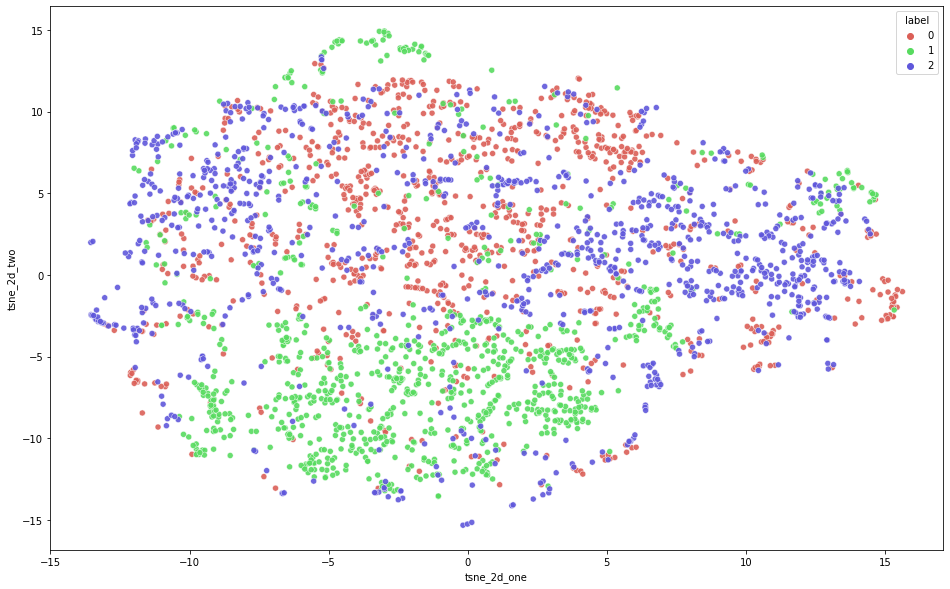

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

w1_df=pd.DataFrame()
w1_df['tsne_2d_one'] = w1_tsne[:,0]
w1_df['tsne_2d_two'] = w1_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
#label = label + label + label + label
w1_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=w1_df,
    legend="full",
    alpha=0.9
)

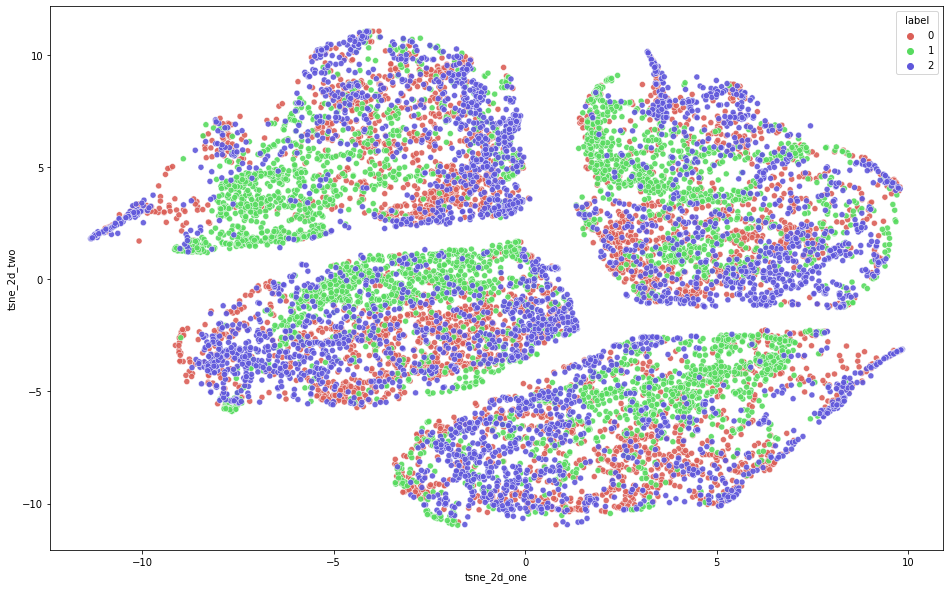

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

cw_df=pd.DataFrame()
cw_df['tsne_2d_one'] = cw_tsne[:,0]
cw_df['tsne_2d_two'] = cw_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
label = label + label + label + label
cw_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=cw_df,
    legend="full",
    alpha=0.9
)

In [ ]:
w1_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w1_pca = PCA(n_components=50)

w1_pca_result = w1_pca.fit_transform(h1)
w1_tsne = w1_tsne_fn.fit_transform(w1_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.035s...
[t-SNE] Computed neighbors for 3000 samples in 0.631s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.381417
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.121132
[t-SNE] KL divergence after 300 iterations: 1.696600


In [ ]:
w2_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
w2_pca = PCA(n_components=50)

w2_pca_result = w2_pca.fit_transform(h2)
w2_tsne = w2_tsne_fn.fit_transform(w2_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.037s...
[t-SNE] Computed neighbors for 3000 samples in 0.734s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.421864
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.660370
[t-SNE] KL divergence after 300 iterations: 1.779933


In [ ]:
nw1_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
nw1_pca = PCA(n_components=50)

nw1_pca_result = nw1_pca.fit_transform(nh1)
nw1_tsne = nw1_tsne_fn.fit_transform(nw1_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 3000 samples in 0.027s...
[t-SNE] Computed neighbors for 3000 samples in 0.698s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3000
[t-SNE] Computed conditional probabilities for sample 2000 / 3000
[t-SNE] Computed conditional probabilities for sample 3000 / 3000
[t-SNE] Mean sigma: 0.412146
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.588081
[t-SNE] KL divergence after 300 iterations: 1.770509


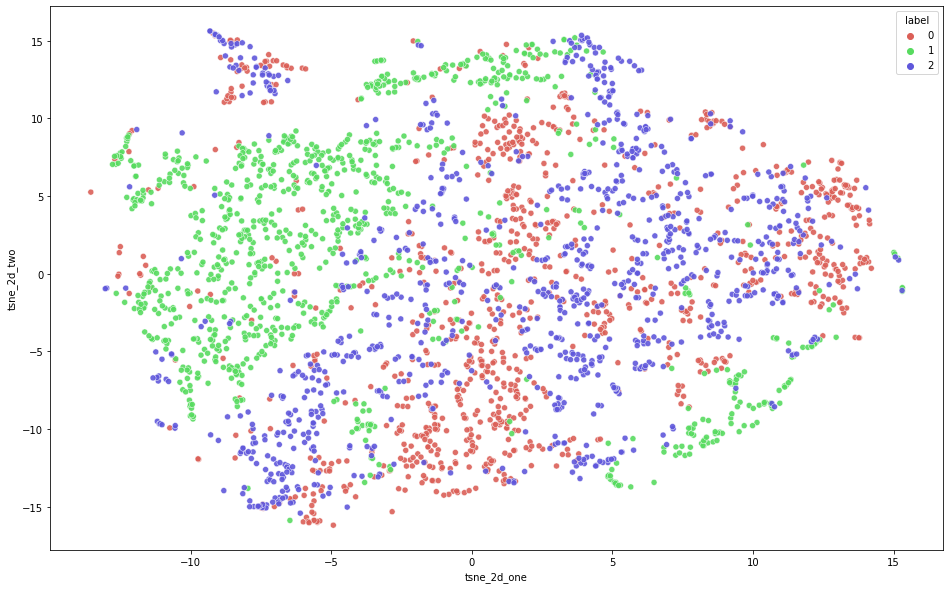

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

w1_df=pd.DataFrame()
w1_df['tsne_2d_one'] = w1_tsne[:,0]
w1_df['tsne_2d_two'] = w1_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
w1_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=w1_df,
    legend="full",
    alpha=0.9
)

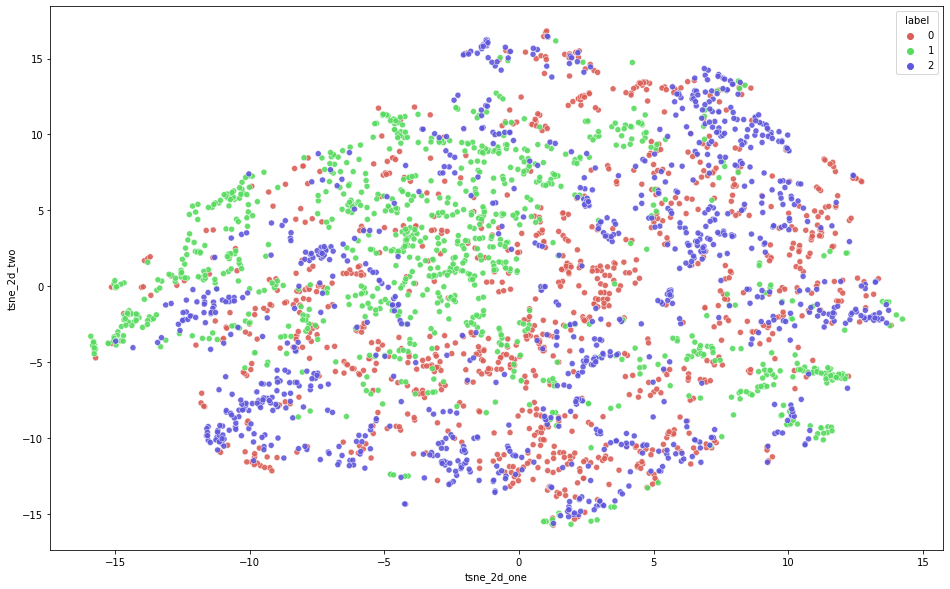

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

w2_df=pd.DataFrame()
w2_df['tsne_2d_one'] = w2_tsne[:,0]
w2_df['tsne_2d_two'] = w2_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
w2_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=w2_df,
    legend="full",
    alpha=0.9
)

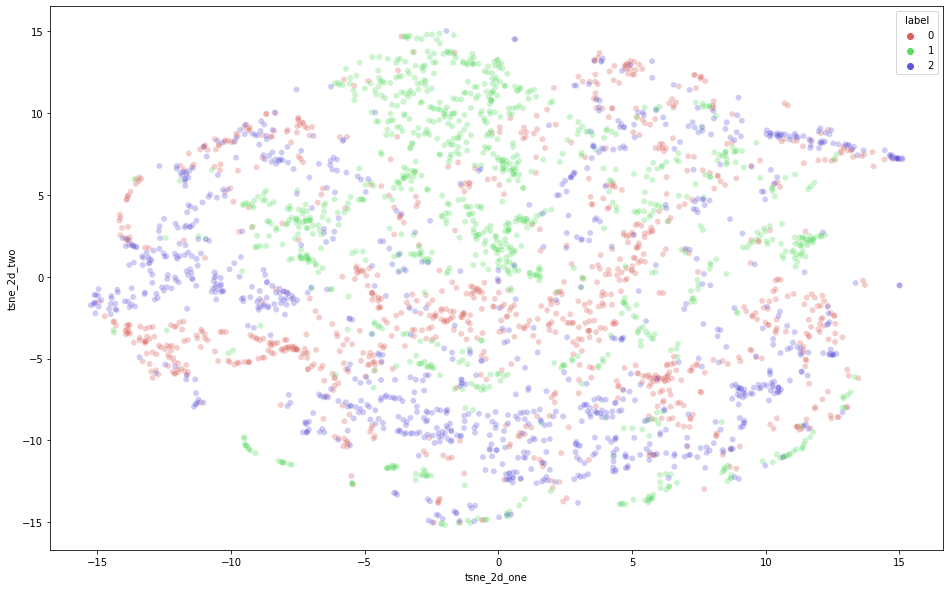

In [ ]:
nw1_df=pd.DataFrame()
nw1_df['tsne_2d_one'] = nw1_tsne[:,0]
nw1_df['tsne_2d_two'] = nw1_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
nw1_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=nw1_df,
    legend="full",
    alpha=0.3
)

In [ ]:
cw_tsne_fn = TSNE(n_components=2, verbose=1, perplexity=40.0, n_iter=300)
cw_pca = PCA(n_components=70)

h=np.append(h1, h2, axis=0)
cw_pca_result = cw_pca.fit_transform(h)
cw_tsne = cw_tsne_fn.fit_transform(cw_pca_result)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 6000 samples in 0.101s...
[t-SNE] Computed neighbors for 6000 samples in 1.809s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6000
[t-SNE] Computed conditional probabilities for sample 2000 / 6000
[t-SNE] Computed conditional probabilities for sample 3000 / 6000
[t-SNE] Computed conditional probabilities for sample 4000 / 6000
[t-SNE] Computed conditional probabilities for sample 5000 / 6000
[t-SNE] Computed conditional probabilities for sample 6000 / 6000
[t-SNE] Mean sigma: 0.399728
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.750229
[t-SNE] KL divergence after 300 iterations: 2.198449


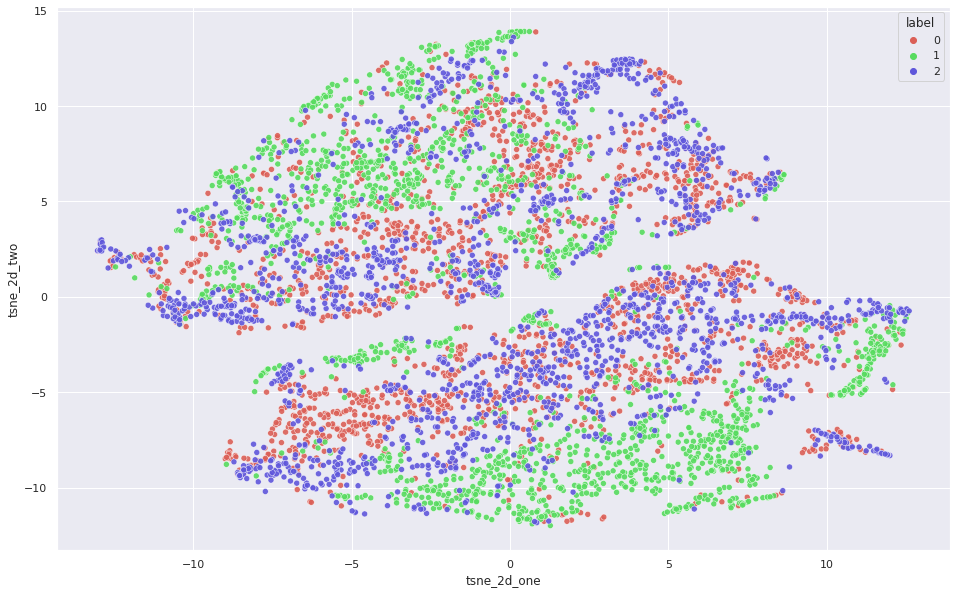

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

cw_df=pd.DataFrame()
cw_df['tsne_2d_one'] = cw_tsne[:,0]
cw_df['tsne_2d_two'] = cw_tsne[:,1]

label = [0 for i in range(1000)] + [1 for i in range(1000)] + [2 for i in range(1000)]
label += label
cw_df['label'] = label

plt.figure(figsize=(16,10))
sns.scatterplot(
    x="tsne_2d_one", y="tsne_2d_two",
    hue='label',  
    palette=sns.color_palette("hls", 3),
    data=cw_df,
    legend="full",
    alpha=0.9
)

In [ ]:
!pip install mpl-toolkits

ERROR: Could not find a version that satisfies the requirement mpl-toolkits (from versions: none)
ERROR: No matching distribution found for mpl-toolkits


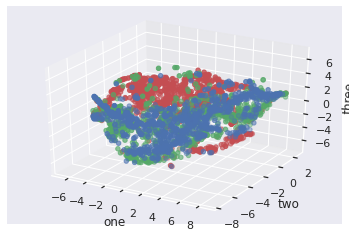

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

sns.set(style = "darkgrid")

fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')

x1 = cw_df['tsne_2d_one'][:1000]
y1 = cw_df['tsne_2d_two'][:1000]
z1 = cw_df['tsne_2d_three'][:1000]

x2 = cw_df['tsne_2d_one'][1000:2000]
y2 = cw_df['tsne_2d_two'][1000:2000]
z2 = cw_df['tsne_2d_three'][1000:2000]

x3 = cw_df['tsne_2d_one'][2000:3000]
y3 = cw_df['tsne_2d_two'][2000:3000]
z3 = cw_df['tsne_2d_three'][2000:3000]

ax.set_xlabel("one")
ax.set_ylabel("two")
ax.set_zlabel("three")

ax.scatter(x1, y1, z1, c='g')
ax.scatter(x2, y2, z2, c='r')
ax.scatter(x3, y3, z3, c='b')

plt.show()

#### FMNIST v3.1
Dynamic Ramping

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 3 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_3/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run1
26422272it [00:01, 15308449.63it/s]                  
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 302143.32it/s]
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:00, 5489579.32it/s]                 
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 18263503.74it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWa

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 4 --epoch 60

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_4/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_1.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_60_run1
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (1000,) and unused (59000,)
No of samples used (10000,) and u

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 5 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  0.0 Other Losses =  7.645382404327393
Contrastive Loss Added =  5.108203411102295 Other Losses =  7.645382404327393
Contrastive Loss Added =  5.20421028137207 Other Losses =  12.753585815429688
Contrastive Loss Added =  5.031517028808594 Other Losses =  17.957796096801758
Contrastive Loss Added =  5.175317764282227 Other Losses =  22.98931312561035
Contrastive Loss Added =  5.108203411102295 Other Losses =  7.108669757843018
Contrastive Loss Added =  0.0 Other Losses =  12.216873168945312
Contrastive Loss Added =  5.65174674987793 Other Losses =  12.216873168945312
Contrastive Loss Added =  5.230798721313477 Other Losses =  17.868619918823242
Contrastive Loss Added =  5.317676544189453 Other Losses =  23.09941864013672
Contrastive Loss Added =  5.20421028137207 Other Losses =  7.082151412963867
Contrastive Loss Added =  5.65174674987793 Other Losses =  12.286361694335938
Contrastive Loss Added =  0.0 Other Los

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 6 --epoch 60

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  3.9467620849609375 Other Losses =  23.381620407104492
Contrastive Loss Added =  4.063205242156982 Other Losses =  6.590294361114502
Contrastive Loss Added =  4.445425033569336 Other Losses =  10.653499603271484
Contrastive Loss Added =  3.951871871948242 Other Losses =  15.09892463684082
Contrastive Loss Added =  4.341543197631836 Other Losses =  19.050796508789062
Contrastive Loss Added =  0.0 Other Losses =  23.3923397064209
Contrastive Loss Added =  3.8846664428710938 Other Losses =  23.3923397064209
Contrastive Loss Added =  4.001072406768799 Other Losses =  6.431869029998779
Contrastive Loss Added =  3.8525428771972656 Other Losses =  10.432941436767578
Contrastive Loss Added =  4.172521591186523 Other Losses =  14.285484313964844
Contrastive Loss Added =  3.9467620849609375 Other Losses =  18.458005905151367
Contrastive Loss Added =  3.8846664428710938 Other Losses =  22.404767990112305
Contrastive Loss 

#### FMNIST v3.2

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 1 --epoch 120

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_1/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_120_run1
26422272it [00:01, 18230625.25it/s]                 
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 344870.31it/s]
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:00, 6170281.39it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 23949631.76it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWar

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 1 --epoch 120

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_1/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_120_run2
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (250,) and unused (59750,)
No of samples used (10000,) and u

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 1 --epoch 120

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_1/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_120_run3
/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)
No of samples used (250,) and unused (59750,)
No of samples used (10000,) and u

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_3.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 3 --epoch 120

Storing in ... ./InfoPro_fmnist_resnet16_K_2_/multiworker/dynamicrampupdown/distance/worker_3/no_1_aux_net_config_1c2f_local_loss_mode_contrast_aux_net_widen_1.0_aux_net_feature_dim_128_alpha_1_5.0_beta_1_1.0_beta_2_1.0_ixx_2_0.0_ixy_2_0.0_gamma_1_0.0_gamma_2_0.0_margin_1.0_a_1.0_b_100.0_skewness_rate_0.5_epochs_120_run1
26422272it [00:01, 15387158.74it/s]                  
Extracting /content/images/FashionMNIST/raw/train-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

29696it [00:00, 276223.90it/s]               
Extracting /content/images/FashionMNIST/raw/train-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

4422656it [00:00, 4909631.83it/s]                
Extracting /content/images/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to /content/images/FashionMNIST/raw

6144it [00:00, 19930242.67it/s]
Extracting /content/images/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to /content/images/FashionMNIST/raw

/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist

#### FMNIST v4.0

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 1.0 --positive_weight 100.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  4.580000787973404
Contrastive Loss Added =  0.0 Other Losses =  6.964958190917969
Contrastive Loss Added =  2.8259973526000977 Other Losses =  6.964958190917969
Contrastive Loss Added =  2.841581344604492 Other Losses =  9.790955543518066
Contrastive Loss Added =  2.8259973526000977 Other Losses =  7.312099456787109
Contrastive Loss Added =  0.0 Other Losses =  10.138096809387207
Contrastive Loss Added =  2.2777490615844727 Other Losses =  10.138096809387207
Contrastive Loss Added =  2.841581344604492 Other Losses =  7.004483222961426
Contrastive Loss Added =  2.2777490615844727 Other Losses =  9.846064567565918
Contrastive Loss Added =  0.0 Other Losses =  12.12381362915039
W1 Epoch: [14][1/2]	Time 2.830 (2.830)	Loss 0.4451 (0.4451)	Prec@1 84.375 (84.375)	
W2 Epoch: [14][1/2]	Time 2.830 (2.830)	Loss 0.5455 (0.5455)	Prec@1 78.906 (78.906)	
W3 Epoch: [14][1/2]	Time 2.830 (2.830)	Loss 0.4307 (0.4307)	Prec@1 85.156 (85.156)	
-

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 100.0 --positive_weight 100.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  5.145338550209999
Contrastive Loss Added =  0.0 Other Losses =  7.233691692352295
Contrastive Loss Added =  6.148991107940674 Other Losses =  7.233691692352295
Contrastive Loss Added =  6.961359024047852 Other Losses =  13.382682800292969
Contrastive Loss Added =  6.148990631103516 Other Losses =  7.091941833496094
Contrastive Loss Added =  0.0 Other Losses =  13.24093246459961
Contrastive Loss Added =  6.716878890991211 Other Losses =  13.24093246459961
Contrastive Loss Added =  6.961359024047852 Other Losses =  7.852235794067383
Contrastive Loss Added =  6.716878890991211 Other Losses =  14.813594818115234
Contrastive Loss Added =  0.0 Other Losses =  21.530473709106445
W1 Epoch: [14][1/2]	Time 2.867 (2.867)	Loss 0.5514 (0.5514)	Prec@1 77.344 (77.344)	
W2 Epoch: [14][1/2]	Time 2.867 (2.867)	Loss 0.5582 (0.5582)	Prec@1 75.781 (75.781)	
W3 Epoch: [14][1/2]	Time 2.867 (2.867)	Loss 0.6211 (0.6211)	Prec@1 75.000 (75.000)	
-ve 

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 300.0 --positive_weight 300.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  14.377723261713982
Contrastive Loss Added =  0.0 Other Losses =  7.139317989349365
Contrastive Loss Added =  18.21504259109497 Other Losses =  7.139317989349365
Contrastive Loss Added =  18.86872673034668 Other Losses =  25.354360580444336
Contrastive Loss Added =  18.215041160583496 Other Losses =  7.275010108947754
Contrastive Loss Added =  0.0 Other Losses =  25.49005126953125
Contrastive Loss Added =  18.817901611328125 Other Losses =  25.49005126953125
Contrastive Loss Added =  18.86872625350952 Other Losses =  7.252951145172119
Contrastive Loss Added =  18.817901611328125 Other Losses =  26.12167739868164
Contrastive Loss Added =  0.0 Other Losses =  44.939579010009766
W1 Epoch: [14][1/2]	Time 2.916 (2.916)	Loss 0.5558 (0.5558)	Prec@1 78.906 (78.906)	
W2 Epoch: [14][1/2]	Time 2.916 (2.916)	Loss 0.6250 (0.6250)	Prec@1 77.344 (77.344)	
W3 Epoch: [14][1/2]	Time 2.916 (2.916)	Loss 0.4574 (0.4574)	Prec@1 82.812 (82.812)	
-

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 500.0 --positive_weight 500.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  26.16492286324501
Contrastive Loss Added =  0.0 Other Losses =  6.716987609863281
Contrastive Loss Added =  30.093460083007812 Other Losses =  6.716987609863281
Contrastive Loss Added =  29.027603149414062 Other Losses =  36.810447692871094
Contrastive Loss Added =  30.093458652496338 Other Losses =  7.489736080169678
Contrastive Loss Added =  0.0 Other Losses =  37.583194732666016
Contrastive Loss Added =  25.35073471069336 Other Losses =  37.583194732666016
Contrastive Loss Added =  29.027603149414062 Other Losses =  7.11639404296875
Contrastive Loss Added =  25.35073471069336 Other Losses =  36.14399719238281
Contrastive Loss Added =  0.0 Other Losses =  61.49473190307617
W1 Epoch: [14][1/2]	Time 2.798 (2.798)	Loss 0.3993 (0.3993)	Prec@1 86.719 (86.719)	
W2 Epoch: [14][1/2]	Time 2.798 (2.798)	Loss 0.6235 (0.6235)	Prec@1 75.781 (75.781)	
W3 Epoch: [14][1/2]	Time 2.798 (2.798)	Loss 0.5291 (0.5291)	Prec@1 78.125 (78.125)	
-

In [7]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 500.0 --positive_weight 500.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
Contrastive Loss Added =  0.0 Other Losses =  44.28917694091797
Contrastive Loss Added =  21.0528564453125 Other Losses =  44.28917694091797
Contrastive Loss Added =  19.901260375976562 Other Losses =  65.34203338623047
Contrastive Loss Added =  21.0528564453125 Other Losses =  43.31073760986328
Contrastive Loss Added =  0.0 Other Losses =  64.36359405517578
Contrastive Loss Added =  22.172882080078125 Other Losses =  64.36359405517578
Contrastive Loss Added =  19.901260375976562 Other Losses =  44.61140441894531
Contrastive Loss Added =  22.172882080078125 Other Losses =  64.51266479492188
Contrastive Loss Added =  0.0 Other Losses =  86.685546875
W1 Epoch: [61][2/2]	Time 5.165 (5.425)	Loss 0.0057 (0.0062)	Prec@1 100.000 (100.000)	
W2 Epoch: [61][2/2]	Time 5.165 (5.425)	Loss 0.0299 (0.0267)	Prec@1 99.180 (99.200)	
W3 Epoch: [61][2/2]	Time 5.165 (5.425)	Loss 0.0017 (0.0016)	Prec@1 100.000 (100.000)	
W1 Val: [61][10/10]	Time 0.392 (0.50

In [8]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 1.0 --gamma_2 0.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 500.0 --positive_weight 500.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  42.27900877594948
Contrastive Loss Added =  0.0 Other Losses =  7.77358341217041
Contrastive Loss Added =  25.170065879821777 Other Losses =  7.77358341217041
Contrastive Loss Added =  26.38532257080078 Other Losses =  32.94364929199219
Contrastive Loss Added =  25.17006826400757 Other Losses =  7.22771692276001
Contrastive Loss Added =  0.0 Other Losses =  32.39778518676758
Contrastive Loss Added =  21.989925384521484 Other Losses =  32.39778518676758
Contrastive Loss Added =  26.385319709777832 Other Losses =  7.623217582702637
Contrastive Loss Added =  21.98992919921875 Other Losses =  34.00853729248047
Contrastive Loss Added =  0.0 Other Losses =  55.99846649169922
W1 Epoch: [14][1/2]	Time 3.004 (3.004)	Loss 0.7599 (0.7599)	Prec@1 71.875 (71.875)	
W2 Epoch: [14][1/2]	Time 3.004 (3.004)	Loss 0.6330 (0.6330)	Prec@1 75.000 (75.000)	
W3 Epoch: [14][1/2]	Time 3.004 (3.004)	Loss 0.6989 (0.6989)	Prec@1 71.875 (71.875)	
-ve los

In [11]:
!CUDA_VISIBLE_DEVICES=0 python train_data_4.py --dataset fmnist --model resnet --layers 16 --droprate 0.0 --local_module_num 2  --local_loss_mode contrast --aux_net_widen 1 --aux_net_feature_dim 128 --alpha_1 5 --beta_1 1.0 --beta_2 1.0 --ixx_2 0 --ixy_2 0 --gamma_1 0.0 --gamma_2 1.0 --skewness_ratio 0.5 --aux_net_config 1c2f --no-augment --contrastive_loss_function "distance" --contrastive_loss_margin 1.0 --negative_weight 500.0 --positive_weight 500.0 --workers 3 --epoch 130

Streaming output truncated to the last 5000 lines.
+ve loss =  26.636652648448944
Contrastive Loss Added =  0.0 Other Losses =  7.789834499359131
Contrastive Loss Added =  33.0108208656311 Other Losses =  7.789834499359131
Contrastive Loss Added =  31.557605743408203 Other Losses =  40.800655364990234
Contrastive Loss Added =  33.01082229614258 Other Losses =  7.657829284667969
Contrastive Loss Added =  0.0 Other Losses =  40.66865158081055
Contrastive Loss Added =  30.656360626220703 Other Losses =  40.66865158081055
Contrastive Loss Added =  31.55760383605957 Other Losses =  7.083311080932617
Contrastive Loss Added =  30.65636444091797 Other Losses =  38.64091491699219
Contrastive Loss Added =  0.0 Other Losses =  69.29727935791016
W1 Epoch: [14][1/2]	Time 3.009 (3.009)	Loss 0.6763 (0.6763)	Prec@1 77.344 (77.344)	
W2 Epoch: [14][1/2]	Time 3.009 (3.009)	Loss 0.8177 (0.8177)	Prec@1 70.312 (70.312)	
W3 Epoch: [14][1/2]	Time 3.009 (3.009)	Loss 0.4695 (0.4695)	Prec@1 83.594 (83.594)	
-ve 